**Goals:**

1. Create visualizations using plotly illustrating
    1. the map of Virginia, color-coded by country according to different features;
    2. an HTML enabled data table to show the raw data;
    3. A correlation matrix between all numeric features;
    4. and a scatterplot with best-fit line showing the relationships between pairs of features.
2. Create a dashboard with tabs for the county-level statistics and relationships

**Building a Dashboard**

Let's make a dashboard with three tabs.

Tab 1: Information about individual cities and counties, including a map that shows the location, and a table of all relevant data

Tab 2: Information about statewide variance in the features, including the full choropleth map, and a box plot comparing cities and counties

Tab 3: Examining relationships between pairs of features, with a scatterplot

**Some Notes:**

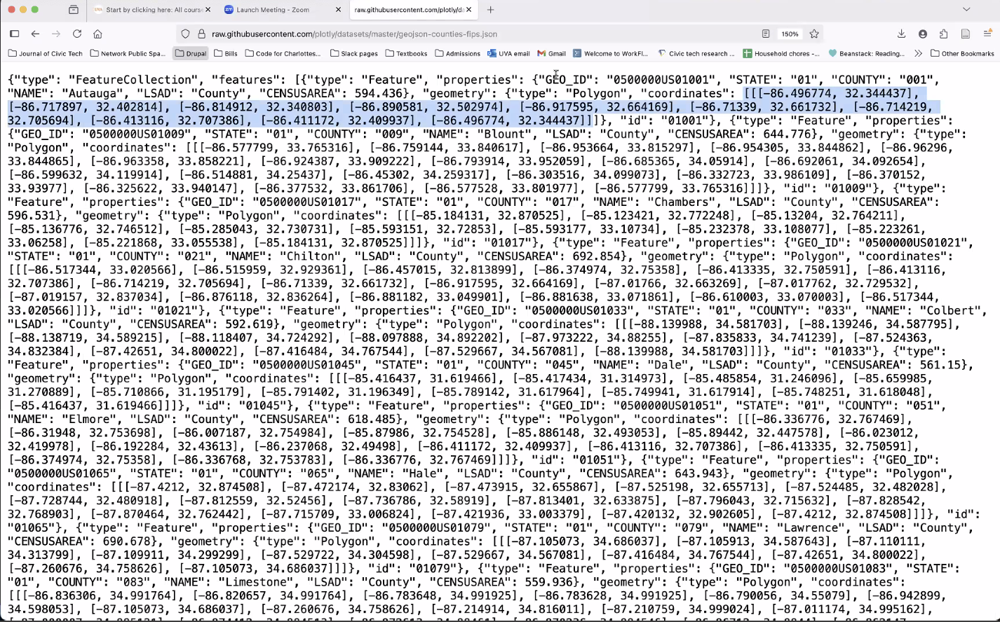

- This is a geo-json, used for GIS related activity. It has geometry for drawing shapes on maps.

For this exercise, we will need the following Python code. First, some preprocessing:

In [1]:
import numpy as np
import pandas as pd
import statsmodels
import requests
import json
import plotly.express as px
import plotly.figure_factory as ff
import dash
from dash import dcc
from dash import html
from dash.dependencies import Input, Output

external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']

vacounties = pd.read_csv('vacounties.csv')
vacounties['income_over_costofliving'] = vacounties['Average Annual Pay'] / vacounties['Cost of living']
vacounties = vacounties.apply(lambda x: x.round(2) if x.dtype == 'float64' else x)
vacounties['city'] = vacounties['FIPS'] > 51500
vacounties['city'] = vacounties['city'].replace({True: 'city', False: 'county'})
r = requests.get('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json')
geojson = json.loads(r.text)

Next, we will need the following Python functions:

In [2]:
def map_place(loc):
    vacounties['location'] = vacounties['Jurisdiction'] == loc
    fig = px.choropleth(vacounties,
                    geojson = geojson,
                    scope = 'usa',
                    locations = 'FIPS',
                    color = 'location',
                    hover_name = 'Jurisdiction',
                    color_continuous_scale = 'reds')
    fig.update_geos(fitbounds='locations')
    fig.update_layout(showlegend=False)
    return fig

 

def loc_table(loc):
    onecounty = vacounties.query('Jurisdiction == @loc')
    onecounty = onecounty.drop(['location', 'city'], axis=1)
    onecounty = onecounty.T.reset_index()
    onecounty.columns = ['Variable', "county"]
    onecounty = onecounty.round(2)
    fig = ff.create_table(onecounty)
    return fig

 

def map_feature(col):
    fig = px.choropleth(vacounties,
                    geojson = geojson,
                    scope = 'usa',
                    locations = 'FIPS',
                    color = col,
                    hover_name = 'Jurisdiction',
                    hover_data = ['Total Population','Average Annual Pay',
                                  'Number in poverty','Cost of living',
                                  'Years of Potential Life Lost Rate'],
                    color_continuous_scale = 'reds')
    fig.update_geos(fitbounds='locations')
    return fig

 

def boxplot(col):
    fig = px.box(vacounties,
                 x = col,
                 y = 'city',
                 color = 'city')
    fig.update_layout(showlegend=False)
    fig.update_yaxes(title='')
    return fig

 

def scatter(col1, col2):
    fig = px.scatter(vacounties,
          y = col2,
          x = col1,
          color = 'Total Population',
          hover_name = 'Jurisdiction',
          trendline = 'ols')
    return fig

Check out the data:

In [3]:
vacounties.head(3).T

,0,1,2
FIPS,51001,51003,51005
Jurisdiction,Accomack County,Albemarle County,Alleghany County
Total Population,33246,113535,14986
American Indian population,1.33,0.94,0.84
Asian population,1.11,6.98,0.61
Black population,29.65,11.08,6.05
Pacific Islander population,0.24,0.21,0.11
Two or more races population,1.83,2.83,1.89
White population,69.56,83.86,94.33
Hispanic population,9.53,5.95,1.77


In [4]:
map_place('Rockingham County')

In [5]:
map_feature("Average Annual Pay")

In [6]:
map_feature('income_over_costofliving')

In [7]:
loc_table("Rockingham County")

In [8]:
boxplot("Average Annual Pay")

In [9]:
scatter('Average Annual Pay', 'Cost of living')

In [ ]:
app = dash.Dash(__name__, external_stylesheets = external_stylesheets)

app.layout = html.Div(
    [
        html.H1("Virginia County Cost and Standard of Living Dashboard"),
        dcc.Tabs(
            [
                dcc.Tab(label='Data for One Locality', children=[
                    html.Div(
                        [
                            dcc.Dropdown(id='localitydropdown',
                                         options=sorted(vacounties['Jurisdiction'].unique()),
                                         value='Goochland County'),
                            html.Div([dcc.Graph(id='localitymap')], style={'width':'65%','float':'left'}),
                            html.Div([dcc.Graph(id='localitytable')], style={'width':'35%','float':'right'})
                        
                            
                        ]
                    )
                ]),
                dcc.Tab(label='Statewide Data', children=[
                    dcc.Dropdown(id='varselect',
                                 options=vacounties.columns,
                                 value='Average Annual Pay'),
                    dcc.Graph(id='varmap')
                ]),
                dcc.Tab(label='Feature Correlations', children=[
                    html.Div([
                    html.Div([
                    dcc.Markdown('Select a variable for the x-axis'),
                    dcc.Dropdown(id = 'varselectx', 
                                 options = vacounties.columns,
                                 value = 'Average Annual Pay')
                ], style={'width': '48%', 'float':'left'}), #dropdown1
                html.Div([
                    dcc.Markdown('Select a variable for the y-axis'),
                    dcc.Dropdown(id = 'varselecty', 
                                 options = vacounties.columns,
                                 value = 'Cost of living')
                ], style={'width': '48%', 'float':'right'})
                ]),
                html.Div([
                    dcc.Graph(id='scatter')
                ], style={'width':'100%', 'float':'left'})  
                ])
            ]
        )
    ]
)

@app.callback(Output(component_id='localitymap', component_property='figure'), 
              [Input(component_id='localitydropdown', component_property='value')])

def map_place(loc):
    vacounties['location'] = vacounties['Jurisdiction'] == loc
    fig = px.choropleth(vacounties,
                    geojson = geojson,
                    scope = 'usa',
                    locations = 'FIPS',
                    color = 'location',
                    hover_name = 'Jurisdiction',
                    color_continuous_scale = 'reds')
    fig.update_geos(fitbounds='locations')
    fig.update_layout(showlegend=False)
    return fig

@app.callback(Output(component_id='localitytable', component_property='figure'),
              [Input(component_id='localitydropdown', component_property='value')])

def loc_table(loc):
    onecounty = vacounties.query('Jurisdiction == @loc')
    onecounty = onecounty.drop(['city'], axis=1)
    onecounty = onecounty.T.reset_index()
    onecounty.columns = ['Variable', loc]
    onecounty = onecounty.round(2)
    fig = ff.create_table(onecounty)
    return fig

@app.callback(Output(component_id='varmap', component_property='figure'), 
              [Input(component_id='varselect', component_property='value')])

def map_feature(col):
    fig = px.choropleth(vacounties,
                    geojson = geojson,
                    scope = 'usa',
                    locations = 'FIPS',
                    color = col,
                    hover_name = 'Jurisdiction',
                    hover_data = ['Total Population','Average Annual Pay',
                                  'Number in poverty','Cost of living',
                                  'Years of Potential Life Lost Rate'],
                    color_continuous_scale = 'reds')
    fig.update_geos(fitbounds='locations')
    return fig

@app.callback(Output(component_id = 'scatter', component_property='figure'), 
              [Input(component_id='varselectx', component_property='value'),
               Input(component_id='varselecty', component_property='value')])

def scatter(col1, col2):
    fig = px.scatter(vacounties,
          y = col2,
          x = col1,
          color = 'Total Population',
          hover_name = 'Jurisdiction',
          trendline = 'ols')
    return fig

if __name__ == '__main__':
    app.run_server(debug=True, port=8051)

[2025-08-09 16:08:50,499] ERROR in app: Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "/Users/landy/anaconda3/envs/ds6001summer2025/lib/python3.13/site-packages/plotly/express/_core.py", line 394, in make_trace_kwargs
    x = x.cast(nw.Float64())
  File "/Users/landy/anaconda3/envs/ds6001summer2025/lib/python3.13/site-packages/narwhals/series.py", line 482, in cast
    return self._from_compliant_series(self._compliant_series.cast(dtype))
                                       ~~~~~~~~~~~~~~~~~~~~~~~~~~~^^^^^^^
  File "/Users/landy/anaconda3/envs/ds6001summer2025/lib/python3.13/site-packages/narwhals/_pandas_like/series.py", line 300, in cast
    return self._from_native_series(ser.astype(pd_dtype))
                                    ~~~~~~~~~~^^^^^^^^^^
  File "/Users/landy/anaconda3/envs/ds6001summer2025/lib/python3.13/site-packages/pandas/core/generic.py", line 6643, in astype
    new_data = self._mgr.astype(dtype=dtype, copy=copy, errors=err